# Sea Level Rise

Leith lies on the coast. Global warming and sea level rise therefore poses a threat to businesses and home owners in this area. 
- What information can be collected from external sources?
- How can these be coupled with the package?
- What does this help tell local people?
- Who would be bale to access this package/information and use it accordingly?
-----
Using the DEM data listed below and a basic understanding of sea level elevation in the coming years, which information can be gained from this package, and if there anything that could be added?

## Sea Level Rise in Leith:

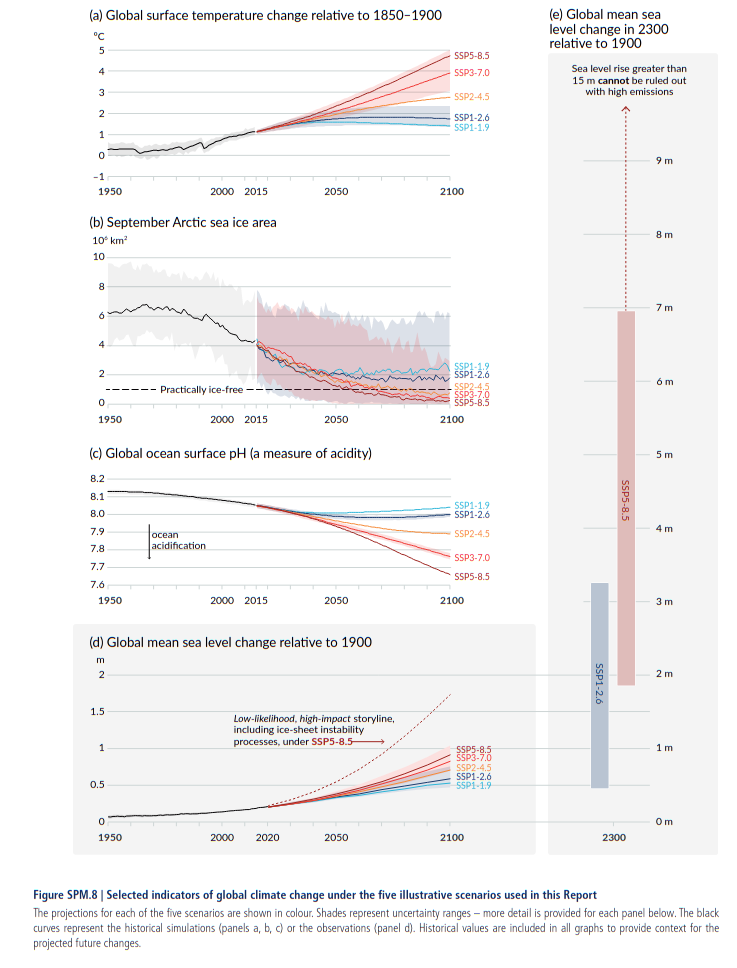

In [1]:
from IPython.display import Image
Image(filename='SEA LEVEL RISE.png') 

The sea is expected to rise in the coming years as the earth warms, ice melts and water expands. Such climatological changes pose a threat to many coastal communities, homes and businesses. 

#### What Sea Level Rise Should We Expect?
Taking the IPCC report and related websites on sea level rise it is expected that the UK could see a sea level increase of 1.5 by 2100 in the image above. https://www.nature.com/articles/d41586-020-00177-3 suggests that SPP2-4.5 is the most likely outcome, so the projection of the SSP2-4.5 path was used for this value. However, considering the 2300 maximum emission was also interesting, so will also be looked at in this notebook- 15m by 2300. 

---

It is also important to consider the natural sea level as well. tidal shifts and floods will create a higher than average sea level already. It is important to consider these when looking at risks to buildings. The tides in Edinbrugh tend to range by around 5m. Assuming that this is about the mean sea level, you could expect that high tide is then around 2.5m above mean sea level. This tidal ranges changes throughout the year, and is at its peak in March and September, during the equinox. The heighest astronomical tide in Leith was  6.24m 30 Sep 2015 https://ntslf.org/tides/hilo. So this can be used as a maximum tidal value possible for Leith. 


The only thing not accounted for is flooding, storm surges and extreme weather. This just allow a slightly larger range to the values posed, but will not be looked at in great detail in this notebook.

### Sources:
Sea Level References: 
- https://www.ipcc.ch/report/ar6/wg1/downloads/report/IPCC_AR6_WGI_SPM_final.pdf
- https://marine.gov.scot/sma/assessment/sea-level-and-tides
- https://coastal.climatecentral.org/map/12/-6.2452/53.3362/?theme=sea_level_rise&map_type=year&basemap=roadmap&contiguous=true&elevation_model=best_available&forecast_year=2050&pathway=ssp3rcp70&percentile=p50&return_level=return_level_1&slr_model=ipcc_2021_med
- https://www.floodmap.net/?gi=2650225

Tidal information: 
- https://ntslf.org/tides/hilo
- https://www.tide-forecast.com/locations/Edinburgh/tides/latest

DEM:
- DEM data can be collected from multiple places, the data used here is 30m resolution data downloaded from ???. 
- LINK

In [31]:
file = 'Edin-30m-DEM.tif'

## Package Load:

The subpackage pertaining to sea level rise has been loaded in as slr to simplify future code in the notebook

In [32]:
import hazards.sea_level_rise as slr
#!pip install numpy==1.23.5
#Need to use an older version of numpy to fit with the current osmnx version. Though this is likely to be fixed

In [34]:
help(slr)

Help on package hazards.sea_level_rise in hazards:

NAME
    hazards.sea_level_rise

PACKAGE CONTENTS
    sea_level_bar_chart
    sea_level_building_density
    sea_level_buildings
    sea_level_buildings_plot

FILE
    /home/s1929650/5_YEAR/hazards 2/hazards/sea_level_rise/__init__.py




## Look at the distribution in the area of Leith from this package:

OpenStreetMaps (OSM) https://www.openstreetmap.org/way/256067272 can be used to find the necessary location and accepted name for the package. 

For this example 'Leith' is able to be used to pull information about Leith from OSM. If Leith is not specified, the area encompassed by the DEM data will be used. This is a possibility, but does make the code run slower. As we are interested in Leith specifically, this destinction has been made in the following code. 

In [35]:
place_name = 'Leith'

In [36]:
slr.sea_level_buildings_plot(file, place = place_name, tag = True) 

### Discussion:
This shows the distribution of all of the listed Leith buildings within OSM. This helps to show the gradual increase in elevation across the region and can highlight the areas at most risk from the expected sea level rise suggested above. 

In [37]:
#below = representation of pixels at certain heights. Lot of buildings are clustered. So it is a combo but 

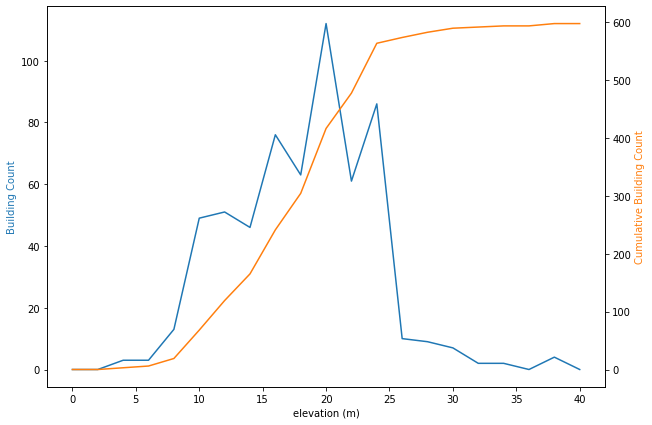

In [38]:
slr.sea_level_building_density(file, place = place_name, step_size = 2, high = 40, title = False)

### Discussion:
The general distribution can also be highlighted above, where the building count is shown. All of the buildings fall within 45m of sea level, with the majority of buildings sitting below 20m elevation. The main thing to be away of is that the DEM is 30m resolution, so will have some discrepencies, as well as the fact that OSM is a volunteer service so may not include all of the buildings that should be there (though important to note that for Edinburgh most buildings are listed, though often without fully detailed tags).

## The Expected Case:
If we used the average 2.5m high tide value, coupled with the 1.5m sea level rise expected by the SPP2-4.5 trajectory from the IPCC report, we can expect that high tide will sit 4m above the current mean sea level (0m).

This can be seen below to only effec the port buildings, and not not cut into man yof the Leith residential areas. 

In [39]:
b, cb = slr.sea_level_buildings(file, place = place_name, low = 0 , high = 4, tag = True)

In [40]:
cb.explore()

## The most extreme tide:

Looking at the most extreme tide in the summer of each year (around 6.24m) coupled with the 1.5m increase expected in the SPP2-4.5 projections we can look at the values expected from 8.24m of elevation above current sea level. 

In [61]:
#b, cb2 = slr.sea_level_buildings(file, place = place_name, low = 0 , high = 8.24, tag = True)

In [62]:
#cb2.explore()

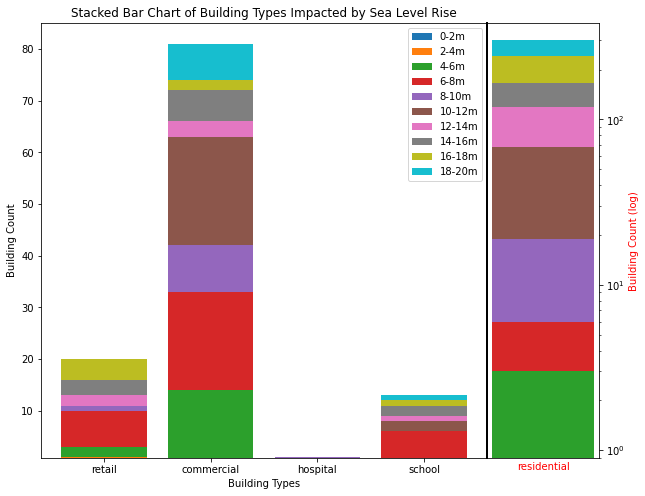

In [44]:
bchart = slr.sea_level_bar_chart(file, place = place_name, step_size = 2, count = 10)

### Discussion:

Looking at the bar chart allows us to easily see the number of each building types that are expected to be at risk with different sea level rises. With the most extreme increase of 8m (red block of the graph and below) it can be seen that nearly 30 commercial buildings fall below this level, close to 10 schools and approximately 70 residential homes. 

This also only takes into account the buildings included within the OSM data, which is often mislabeled. So this number is likely to be higher. Though it is using DEM with a 30m resolution, so it may be in areas with more rapid inclines that buildings are included that should not be, particularly with such small elevation intervals. 

## 2300 year extreme:

The 2300 extreme suggested there is a possible increase of sea level to 15m, with unchecked CO$_{2}$ production in the worst 'business as usual' approach. This will impact a lot of the buildings in Leith, which was shown above to have a lot of buildings included below 20 m of elevation. 

In [63]:
#b, cb3 = slr.sea_level_buildings(file, place = place_name, low = 0 , high = 22.5, tag = True)

In [64]:
#cb3.explore()

This also suggests that such an increase would also impact Edinburgh as a whole, and not just Leith. So looking at all of the values for the region included within the data is also helpful for the larger scale impact that this could have. This is a large dataset to run for all building types, so I have specified just the residential buildings within the region. 

In [47]:
#b, cb4 = slr.sea_level_buildings(file,low = 0 , high = 22.5, tag = 'residential')

In [65]:
#cb4.explore()

This is the whole area of the DEM and is a slightly wider region that desired, so specifying Edinburgh could be useful, although this will discount Leith buildings.

In [49]:
b, cb5 = slr.sea_level_buildings(file,place= 'City of Edinburgh' ,low = 0 , high = 22.5, tag = 'residential')

In [50]:
cb5.explore()

In [51]:
#this is important non risk. Bucket filling algorithm. Nature paper for coastal flooding. Flood defenses and 30 meter res isnt gonnna show sea defenses
#flood defenses shape  file 

This shows the wide reaching impact that 200 years of sea level rise could have on a city like Edinburgh and across to Musselburgh. This shows part of the reson why managing sea level rise, even for a place like Scotland is so important. Edinburgh is not a region of high risk from sea level rise, however it is clear that as the sea level rise increases the risk in Edinburgh will increase, particularly across Leith. 

This also does not account for flooding or storm surges, which would only increase these values further. 

The bar chart here alo shows that the 5-10m range seems to have the largest inpact on the linear categories like schools, commercial and retail buildings. This is useful in highlighting the people and local communities where the largest risk elevation are in the foreseeable future. 

----


One thing to take into account in this data is it does not account for any sea level rise and flood prevention technology like sea level walls. It also does not take into acount flow path, so may include locations that may ne surrounded in high elevation buildings that would realistically be difficult to get to. 


----

NOTE: it is important to take into account what you are plotting. Most articles based on Sea Level Rise in Leith use the visual map provided above, which demonstrates flooding height in different years based on some probability. It does not show the sea level, which is what it has been taken to mean in many articles. So my aware of what you are displaying and what other factors could be at play. 

# This Package As A Tool?

The above graphs show how this package can be utilised to explore the sea level rise impact on a region when there is good 3rd party data. This shows similar results and information as that shown from online interactable maps, but allows for more precise changes and gives additional information in the form of barchart, line graphs and building specific information. 

This does rely on reliable OSM data, but it is a readily available source of building information and is a useful start for creating this kind of resource. 

In [55]:
import matplotlib.pyplot as plt

In [57]:
import contextily as ctx

In [58]:
cb2 = cb2.to_crs(epsg = 3857)
cb3 = cb3.to_crs(epsg = 3857)
cb  =  cb.to_crs(epsg = 3857)
#Spherical Mercator projection 

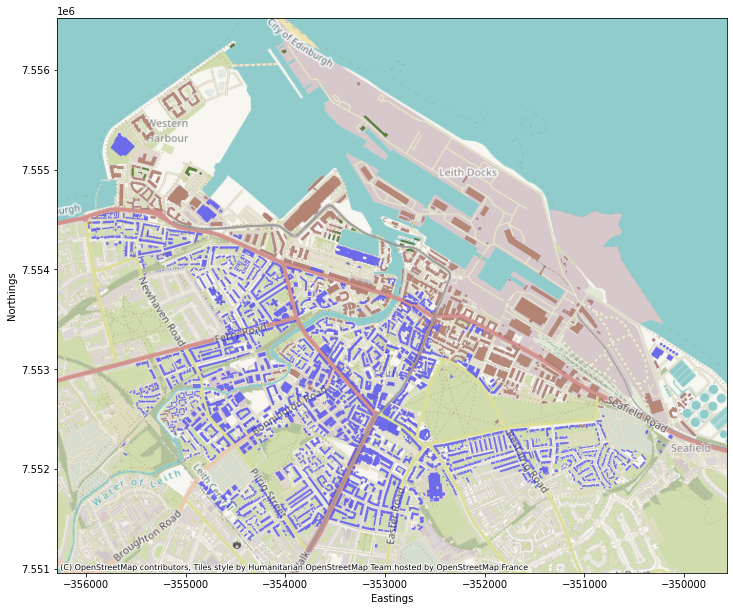

In [59]:
# Plot the GeoDataFrame
ax = cb3.plot(figsize=(12, 12), alpha=0.5, color = 'blue', label = 'Buildings under 4 m')
cb2.plot(ax = ax, figsize=(12, 12), alpha=0.5, color = 'orange', label = 'Buildings under 8.24 m')
cb.plot(ax = ax, figsize=(12, 12), alpha=0.5, color = 'green', label = 'Buildings under 22.5 m')

# Add the basemap
ctx.add_basemap(ax, crs=cb.crs.to_string())

ax.set_xlabel('Eastings')
ax.set_ylabel('Northings')

plt.savefig('3 compiled.png')